# WASP-43 - observed on 08-09.03.2022

Take photometric measurements of WASP-43 from the images taken on the night of 08-09.03.2022 with the SPA-2 telescope belonging to Telescope Live.

To measure the flux of a different target, change only the following variables:
* **R0** in code cell 2 --> aperture radius;
* **inner_annulus0** in cell 2 --> inner annulus multiplier;
* **outer_annulus0** in cell 2 --> outer annulus multiplier;
* **low_lim0** and **hi_lim0** in cell 2 for image contrast;
* **x_center0** and **y_center0** in cell 2 --> the x and y pixel coordinates of your target;
* **full_file_paths** in cell 3 --> change the name of the folder where your images are stored if you have frames of a different field. Save that folder in the same directory as this Jupyter Notebook.

In [1]:
## Import modules:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from astropy.io import fits
from astropy.time import Time

plt.rcParams["figure.figsize"] = (10,8)

In [2]:
## Set global parameters:

## Aperture parameters:
R0 = 20    # radius
inner_annulus0 = 2
outer_annulus0 = 3


## Viewing options:
low_lim0 = 0      # for contrast (from 0 to 100 in percentiles)
hi_lim0 = 0.5     # for contrast (from 0 to 100 in percentiles)
cmap_value0 = 'viridis'   # colour map

## Locate the centre of the star (do this in GAIA or SAO DS9):
x_center0 = 2046
y_center0 = 2048

## Set the edges of a box (the original image will be too big; make a smaller stamp in the vicinity of the star):
x_corner_lo = x_center0 - 75  # change these 4 coords. with suitable constants if they don't work for a different target
x_corner_hi = x_center0 + 75
y_corner_lo = y_center0 - 75
y_corner_hi = y_center0 + 75


## The new coordinates of the star will be calculated in terms of the origin of the small stamp:
x_center0 = x_center0 - x_corner_lo
y_center0 = y_center0 - y_corner_lo

In [3]:
def get_filepaths(directory):
    """
    This function will generate the file names in a directory 
    tree by walking the tree either top-down or bottom-up. For each 
    directory in the tree rooted at directory top (including top itself), 
    it yields a 3-tuple (dirpath, dirnames, filenames).
    """
    file_paths = []  # List which will store all of the full filepaths.

    # Walk the tree.
    for root, directories, files in os.walk(directory):
        for filename in files:
            # Join the two strings in order to form the full filepath.
            filepath = os.path.join(root, filename)
            file_paths.append(filepath)  # Add it to the list.

    return file_paths  # Self-explanatory.

# Run the above function and store its results in a variable.   
full_file_paths = get_filepaths("./TelescopeLive_WASP-43b_SPA-2_08_03_2022/Processed")

## Save all the file names from a folder in a list:
fits_image_filename_list = full_file_paths

In [4]:
## Define necessary functions:

JD_time_list = []

## Read the FITS image, store it into a variable:

def read_img0():

    global large0, x_center0, y_enter0, JD_time, JD_time_list, year_csv,month_csv,day_csv,hour_csv,minute_csv,second_csv
    global x_max, y_max, date_string,time_string
    
    HDUlist0 = fits.open(fits_image_filename0)      # open FITS file
    
    ## Open header and extract the date and time of the observation:
    header = HDUlist0[0].header
    time = header['DATE-OBS']
    
    ## Separate the date and time in 2 different strings (FITS formatfor date: 2022-03-09T00:29:22.63)
    sep = "T"  # separation string
    date_string = time[:time.index(sep)]  # all the characters up to the separation
    time_string = time[time.index(sep) + len(sep):]  # all the characters after the separation
    
    ## Split the date string into year, month and day:
    splitted_date=date_string.split('-')
    year_csv = splitted_date[0]      # these will be exported to a CSV spreadsheet at the end
    month_csv = splitted_date[1]
    day_csv = splitted_date[2]

    ## Split the time string into hour, minute, second:
    splitted_time=time_string.split(':')
    hour_csv = splitted_time[0]          # these will be exported to a CSV spreadsheet at the end
    minute_csv = splitted_time[1]
    second_csv = splitted_time[2]
    
    ## Use the Astropy Time object to convert the string to a time object and then to Julian date:
    t = Time(time, format='isot', scale='utc')
    JD_time = t.jd   # convert to JD
    JD_time_list.append(JD_time)

    large0 = HDUlist0[0].data         # store the FITS img in a variable
    
    global img0
    img0 = large0[x_corner_lo:x_corner_hi,y_corner_lo:y_corner_hi]         # take a section of the image
    
    ## Find the pixel with the highest counts within the smaller section just defined:
    max_pos = np.where(img0 == np.amax(img0))
    
    ## Only keep the first pixel found with the highest counts (sometimes 2 pixels near the centre of the star have the same 
    ## highest value for the counts)
    if len(max_pos) > 1:
        x_max = int(max_pos[0][0])
        y_max = int(max_pos[1][0])
    else:
        x_max = int(max_pos[0])
        y_max = int(max_pos[1])  
    
    global x_size0
    x_size0 = img0.shape[0]                    # save the image (or section) size
    global y_size0
    y_size0 = img0.shape[1]

In [5]:
## Function to plot apertures and annuli:

def circle(R,x,y,color_string):
    '''
    This function creates a circle of radius R centred at the point (x,y). The color of the circle must 
    also be specified.
    '''
    theta = np.linspace(0, 2*np.pi, 100) 
    
    a = x + R * np.cos(theta)
    b = y + R * np.sin(theta)
    
    plt.plot(a,b,color=color_string)

In [6]:
## Aperture photometry function (calculates signal and sky; prints the values next to the image):

## The cell_text array will store a table of all the data that will be exported to a CSV spreadsheet:
cell_text = []
signal_list = []

def Run0():

    global x_center0, y_center0, signal0, sky_bckg0, signal_list
    
    w = np.where(img0!=None)   # all indices in the image1 array

    ## Calculate the distance (in pixels) from all pixels to the star's centre:
    dist = np.sqrt( (w[0] - x_center0)**2 + (w[1] - y_center0)**2 ) # popt[0]=cenx and popt[1]=ceny;
                                                                            # w[0] gives y coords., w[1] gives x coords.
    dist = dist.reshape(x_size0,y_size0)                                # reshape to the 100x100 shape of the image
    
    ## Find all pixels within the aperture radius:
    ww = np.where(dist < R0)     
    
    ## Calculate the no. of pixels within the circular aperture:
    no_pixels = np.array(ww).shape[1]
    
    
    ## Calculate the total signal within the aperture:
    total_signal = np.sum(img0[ww])

    ## Find all pixels within the background ring:
    m = np.where( (dist > inner_annulus0*R0) & (dist < outer_annulus0*R0) )

    plt.imshow(img0.T, origin='lower',cmap=cmap_value0,vmin=low_lim0/100*np.max(large0),vmax=hi_lim0/100*np.max(large0))
                                               # plot the image
    plt.xlabel('x')
    plt.ylabel('y\n\n', rotation='horizontal')

    ## Calculate the total sky background:
    total_sky_bckg = np.sum(img0[m])

    ## Divide by no. of pixels within ring to get the mean background per pixel:
    sky_bckg0 = total_sky_bckg / np.array(m).shape[1]
    print("Mean sky background per pixel:",sky_bckg0)##

    plt.text(0.9, 1.1, "Sky: %.4f" % (sky_bckg0, ), transform=ax0.transAxes, \
        verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

    ## Find the total signal from the star (after background subtraction from each pixel):
    signal0 = np.sum(img0[ww] - sky_bckg0)
    print("Signal (after background subtraction):",signal0) ##
    plt.text(0.9, 1.03, "Star: %.4f" % (signal0, ), transform=ax0.transAxes, \
        verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))


    ## Print x and y- positions of the click:
    plt.text(0.95, -0.02, "x = %.1f" % (x_center0, ), transform=ax0.transAxes, \
        verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

    plt.text(0.95, -0.09, "y = %.1f" % (y_center0, ), transform=ax0.transAxes, \
        verticalalignment='top', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
    plt.draw()
    
    ## Calculate the statistical uncertainty in the flux measurement (from the SNR):
    gain = 1.4
    N_S = gain * signal0    # total aperture signal in photoelectrons
    N_B = gain * np.pi * R0**2 * sky_bckg0  # total background within the aperture in photoelectrons (multiply by aperture area)
    #N_B = gain * no_pixels * sky_bckg0     # equivalently

    SNR = N_S / np.sqrt(N_S + 2* N_B)       # SNR (see PHAS0043 lectures)

    sigma_N_S_photoel = N_S / SNR                   # flux uncertainty in photoelectrons
    sigma_N_S = sigma_N_S_photoel / gain            # flux uncertainty in ADU
    print("Flux uncertainty:",sigma_N_S)
    
    ## Populate the cell_text table for the spreadsheet at the end:
    cell_text.append([round(signal0,4),round(sky_bckg0,4),round(sigma_N_S,2),"{:.7f}".format(JD_time),year_csv,month_csv,day_csv,hour_csv,minute_csv,second_csv])

    signal_list.append(signal0)

In [7]:
## Function which draws the aperture and annuli, then calculates sky and signal by calling 'Run()':

def aperture_photom0(R0,inner_annulus0,outer_annulus0):

    ## Display the circular aperture around the star and the ring that contains the sky background:
    C1 = circle(R0,x_center0,y_center0,'red')
    C2 = circle(inner_annulus0*R0,x_center0,y_center0,'orange')
    C3 = circle(outer_annulus0*R0,x_center0,y_center0,'orange')
    
    Run0()

In [8]:
## Main function (runs the program by calling all previous functions):

img_no = 0   # count each image for the title

def main():
    
    global img_no, x_center0, y_center0, x_corner_lo, y_corner_lo, x_corner_hi, y_corner_hi, date_string, time_string
    img_no = img_no + 1    # count images
    
    read_img0()    # read the image    
    
    ## Re-set the centre of the aperture for the new frame:
    x_center0 = x_max + x_corner_lo
    y_center0 = y_max + y_corner_lo
    
    ## Set the corners of the small stamp around the star:
    x_corner_lo = int(x_center0 - 75)
    x_corner_hi = int(x_center0 + 75)
    y_corner_lo = int(y_center0 - 75)
    y_corner_hi = int(y_center0 + 75)

   
    ## Set the aperture centre in terms of the small stamp coordinates:
    x_center0 = x_center0 - x_corner_lo
    y_center0 = y_center0 - y_corner_lo
    print("x_center:",x_center0)
    print("y_center:",y_center0)

    plt.title('Image no.'+str(img_no)+'\nWASP-43. Observed on '+str(date_string)+'\nat '+str(time_string)+' UT.\n')   
                                                                                                            # title of plot
    plt.xlabel('x')
    plt.ylabel('y\n\n',rotation='horizontal')
    plt.draw()
    
    aperture_photom0(R0,inner_annulus0,outer_annulus0)     # do aperture photometry

x_center: 75
y_center: 75
Mean sky background per pixel: 141.71593090211132
Signal (after background subtraction): 334438.6660268714
Flux uncertainty: 702.34792353009


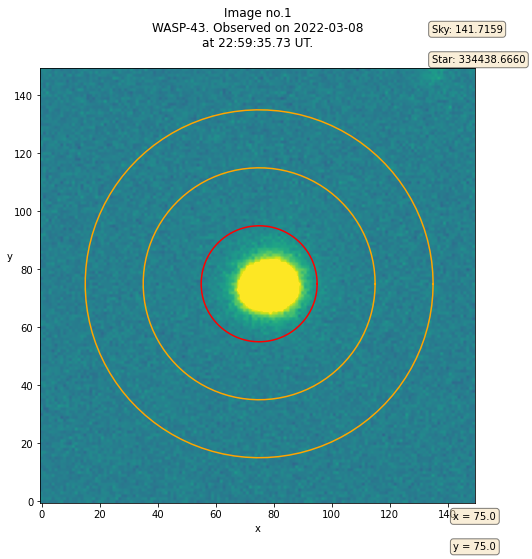

x_center: 75
y_center: 75
Mean sky background per pixel: 141.71337172104927
Signal (after background subtraction): 335353.85220729373
Flux uncertainty: 702.8098717793578


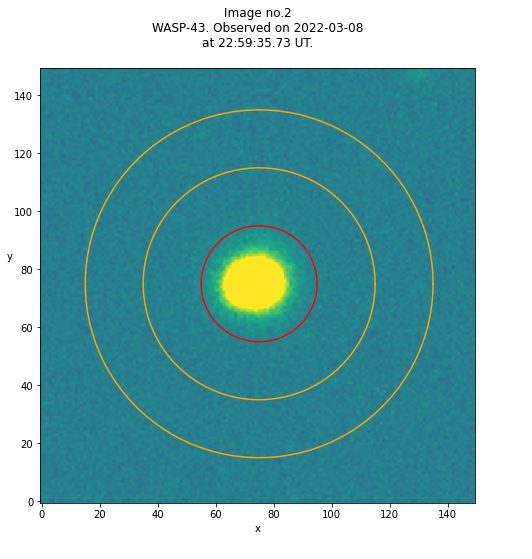

x_center: 75
y_center: 75
Mean sky background per pixel: 141.53646833013437
Signal (after background subtraction): 334041.09692898276
Flux uncertainty: 701.9162751383725


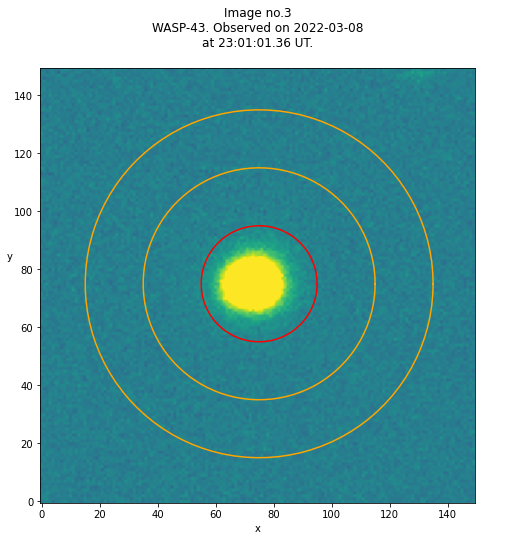

x_center: 75
y_center: 75
Mean sky background per pixel: 141.6289187460013
Signal (after background subtraction): 335143.9961612284
Flux uncertainty: 702.59533806344


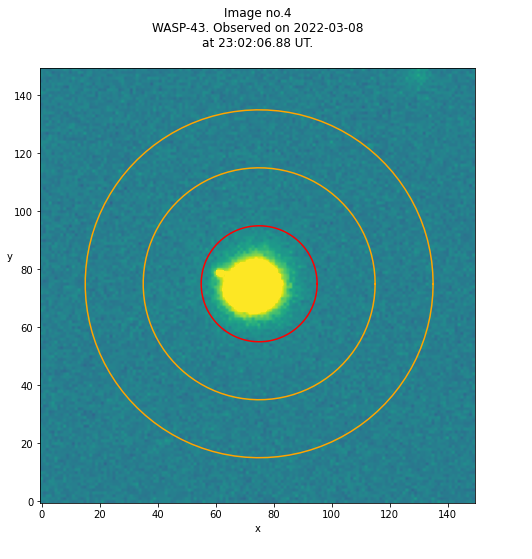

x_center: 75
y_center: 75
Mean sky background per pixel: 141.30230326295586
Signal (after background subtraction): 331255.63243761996
Flux uncertainty: 700.1974490561295


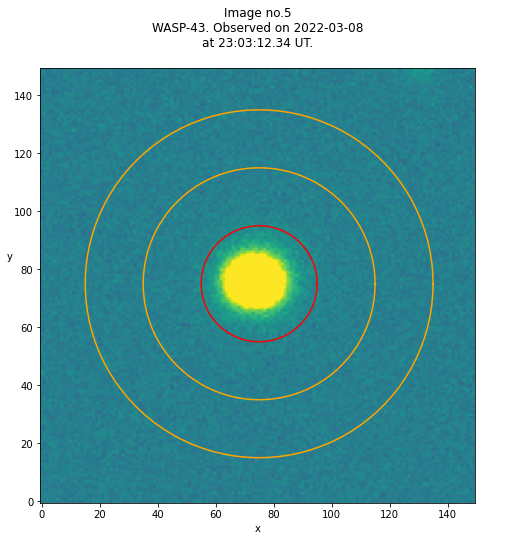

x_center: 75
y_center: 75
Mean sky background per pixel: 141.22872680742162
Signal (after background subtraction): 327854.23512476013
Flux uncertainty: 698.3658167546723


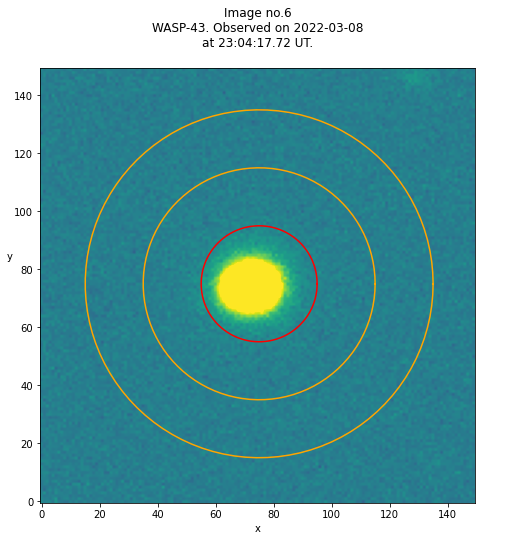

x_center: 75
y_center: 75
Mean sky background per pixel: 140.8283749200256
Signal (after background subtraction): 331579.67322456825
Flux uncertainty: 699.7550508556351


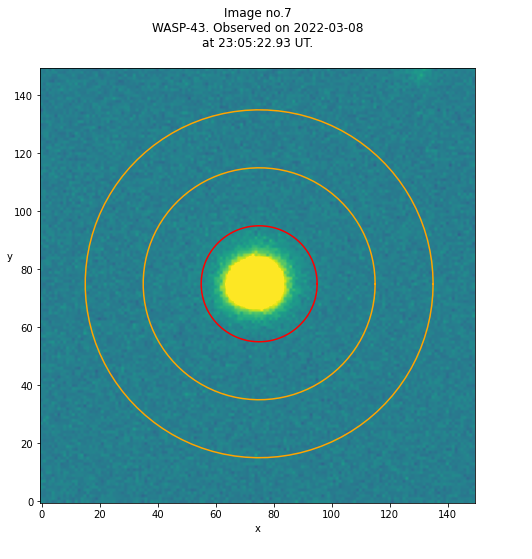

x_center: 75
y_center: 75
Mean sky background per pixel: 141.1868202175304
Signal (after background subtraction): 329784.4088291747
Flux uncertainty: 699.298419117563


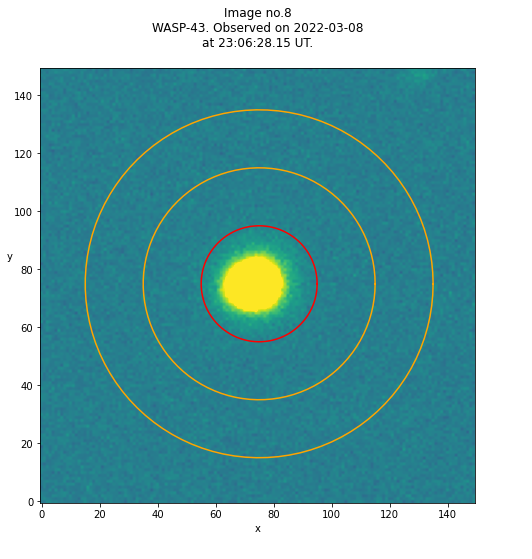

x_center: 75
y_center: 75
Mean sky background per pixel: 140.4435380678183
Signal (after background subtraction): 328856.79510556615
Flux uncertainty: 697.8691573312801


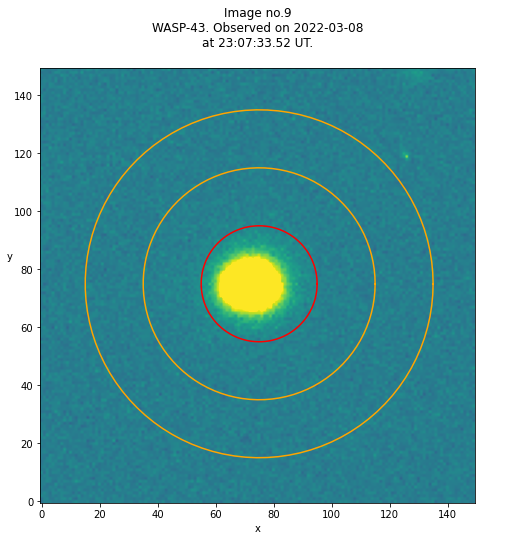

x_center: 75
y_center: 75
Mean sky background per pixel: 140.67802303262957
Signal (after background subtraction): 329794.8613243762
Flux uncertainty: 698.6503807183493


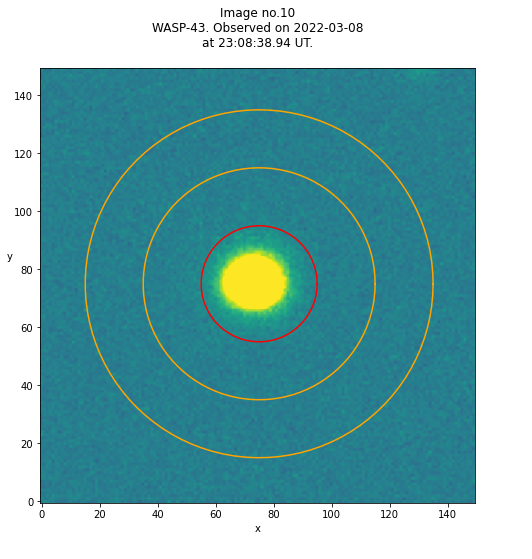

x_center: 75
y_center: 75
Mean sky background per pixel: 140.65035188739603
Signal (after background subtraction): 326741.31190019194
Flux uncertainty: 697.0520587607306


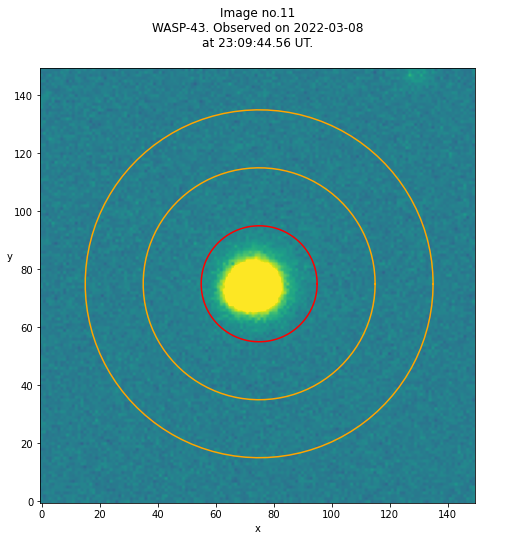

x_center: 75
y_center: 75
Mean sky background per pixel: 140.19849648112603
Signal (after background subtraction): 328162.8718809981
Flux uncertainty: 697.1985396430438


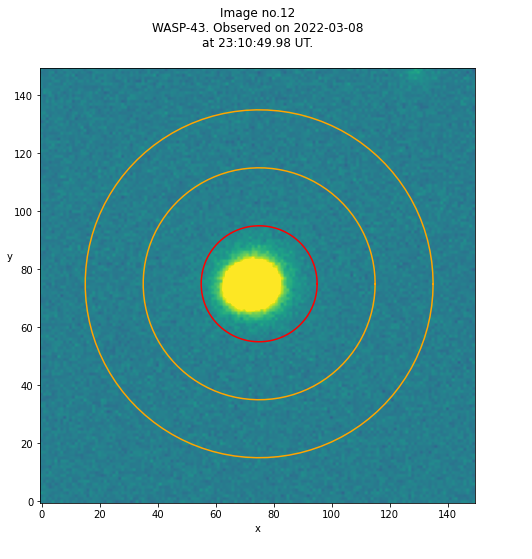

x_center: 75
y_center: 75
Mean sky background per pixel: 140.06797824696096
Signal (after background subtraction): 325676.36708253366
Flux uncertainty: 695.7552896229267


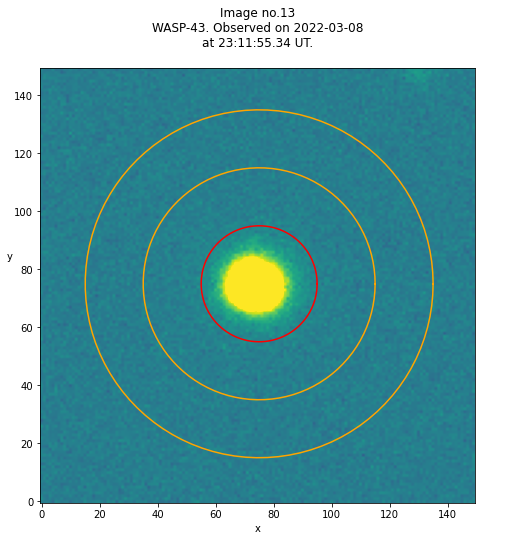

x_center: 75
y_center: 75
Mean sky background per pixel: 140.02175303902752
Signal (after background subtraction): 327040.9174664108
Flux uncertainty: 696.3958059786677


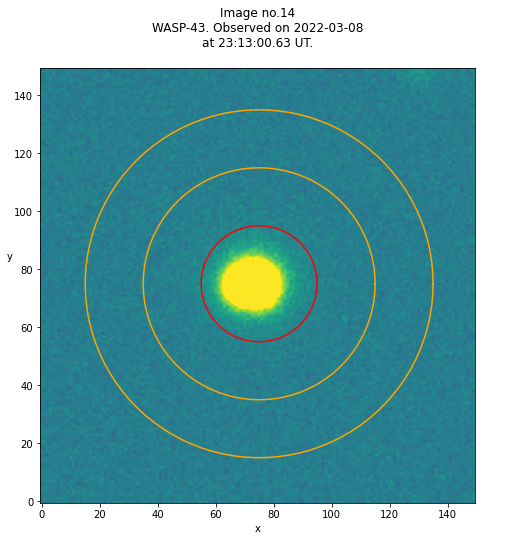

x_center: 75
y_center: 75
Mean sky background per pixel: 139.99888035828536
Signal (after background subtraction): 326586.39395393466
Flux uncertainty: 696.1331754718054


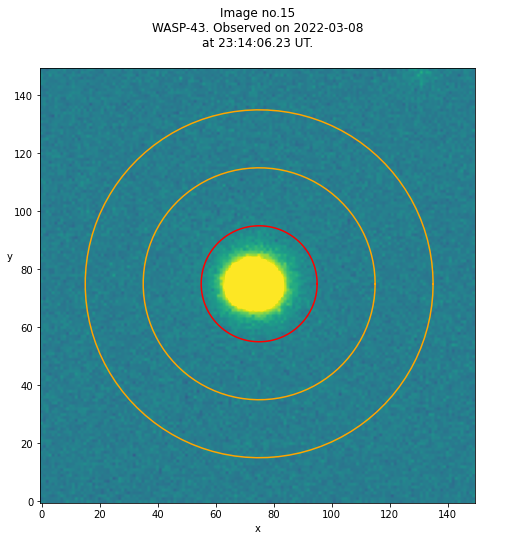

x_center: 75
y_center: 75
Mean sky background per pixel: 139.69705694177864
Signal (after background subtraction): 326582.1641074856
Flux uncertainty: 695.7417225833834


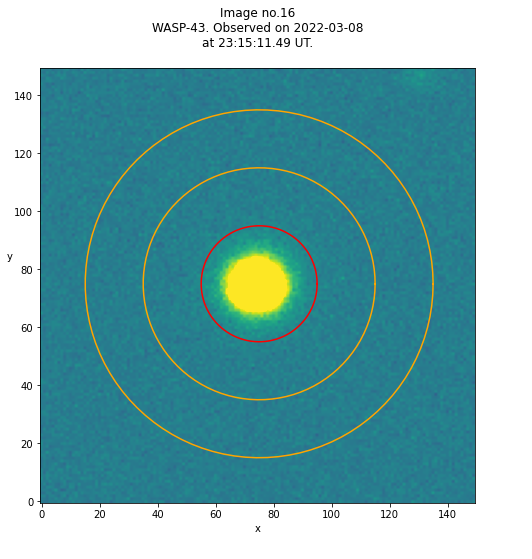

x_center: 75
y_center: 75
Mean sky background per pixel: 139.74744081893795
Signal (after background subtraction): 323636.4361804222
Flux uncertainty: 694.2930952354252


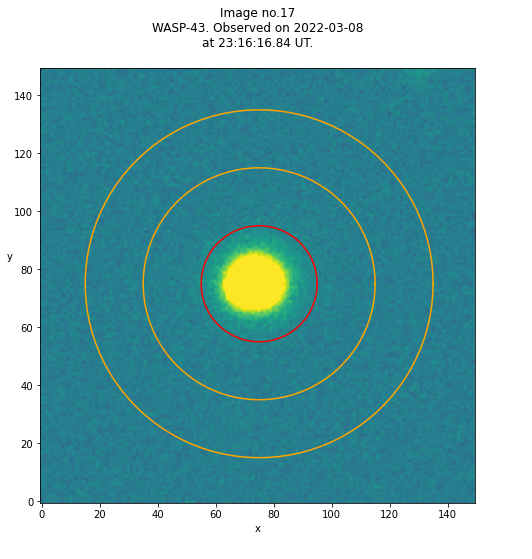

x_center: 75
y_center: 75
Mean sky background per pixel: 139.5227127319258
Signal (after background subtraction): 322385.2226487524
Flux uncertainty: 693.3583108479967


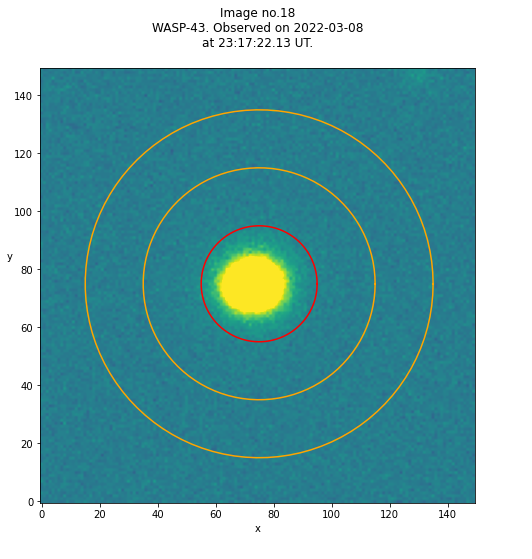

x_center: 75
y_center: 75
Mean sky background per pixel: 139.28806781829815
Signal (after background subtraction): 324624.3555662187
Flux uncertainty: 694.2073856661303


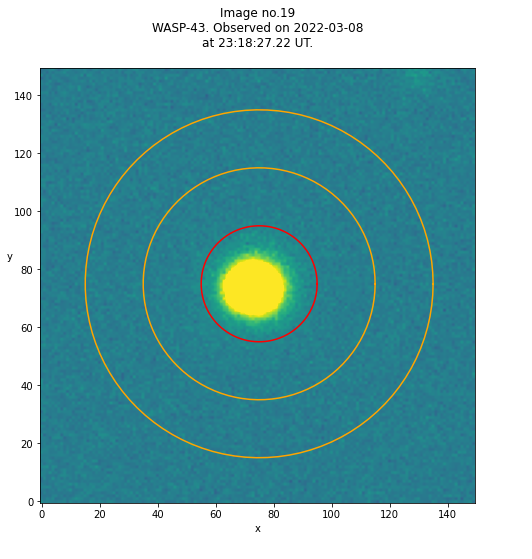

x_center: 75
y_center: 75
Mean sky background per pixel: 139.00639795265516
Signal (after background subtraction): 326126.0345489443
Flux uncertainty: 694.6156272341134


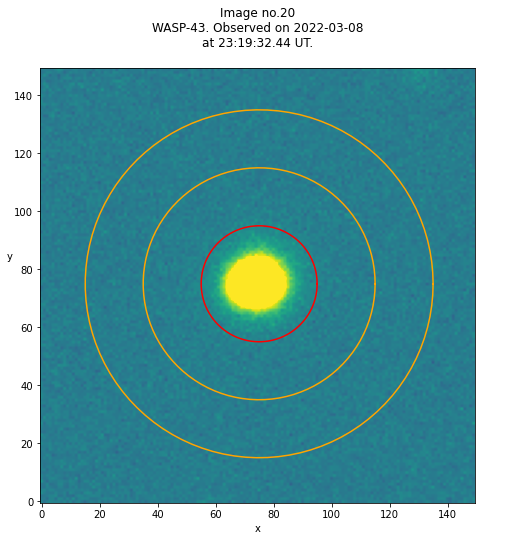

x_center: 75
y_center: 75
Mean sky background per pixel: 138.8117402431222
Signal (after background subtraction): 326540.3833973129
Flux uncertainty: 694.5771262847421


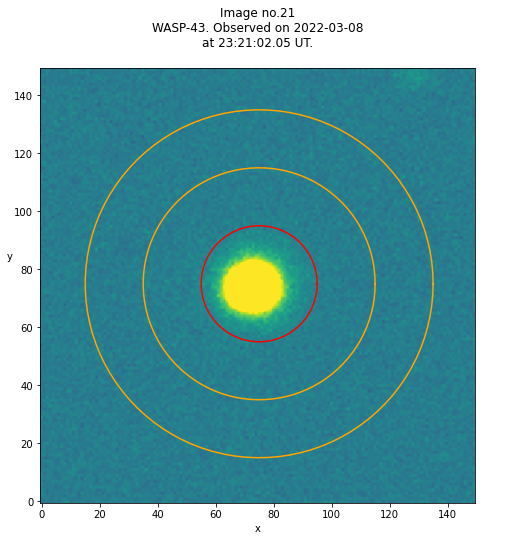

x_center: 75
y_center: 75
Mean sky background per pixel: 138.94865642994242
Signal (after background subtraction): 326477.92274472176
Flux uncertainty: 694.7219306815731


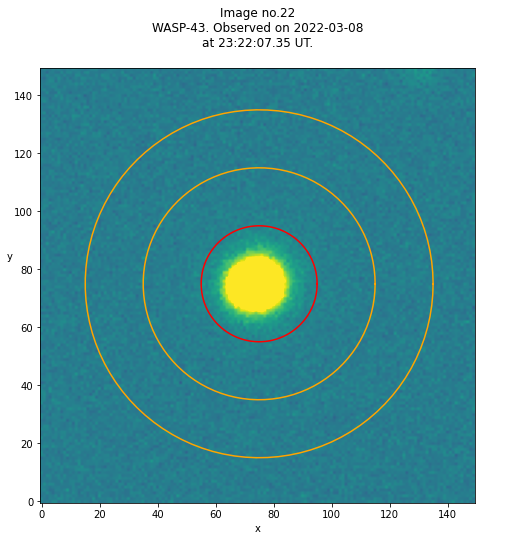

x_center: 75
y_center: 75
Mean sky background per pixel: 138.8736404350608
Signal (after background subtraction): 324222.31765834935
Flux uncertainty: 693.4643077192712


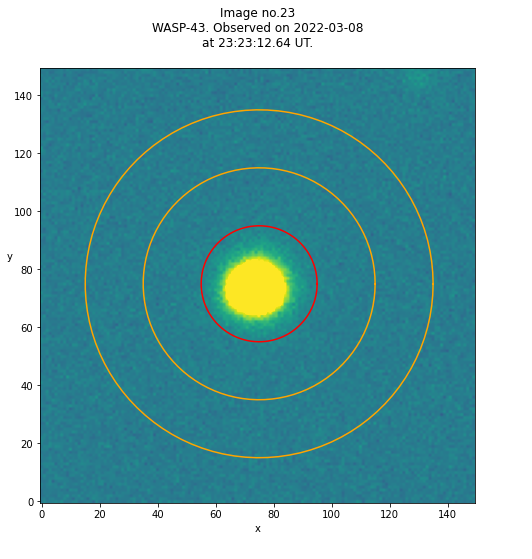

x_center: 75
y_center: 75
Mean sky background per pixel: 138.2530390275112
Signal (after background subtraction): 324016.96641074854
Flux uncertainty: 692.5546661285417


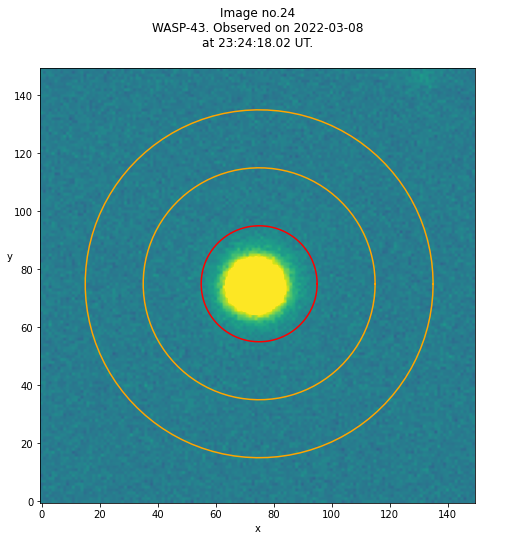

x_center: 75
y_center: 75
Mean sky background per pixel: 138.377959053103
Signal (after background subtraction): 321527.44097888673
Flux uncertainty: 691.4318397576299


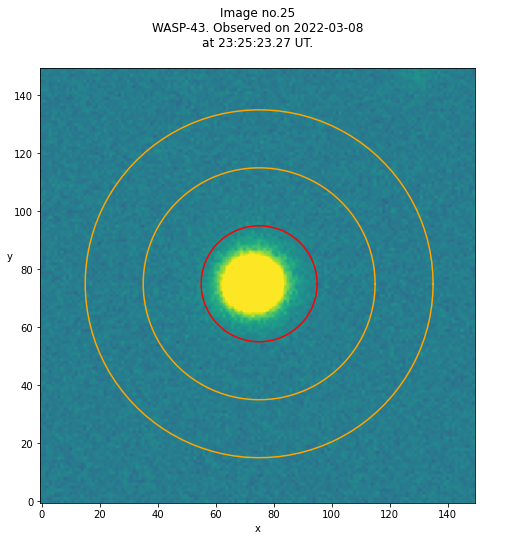

x_center: 75
y_center: 75
Mean sky background per pixel: 138.2530390275112
Signal (after background subtraction): 323562.96641074854
Flux uncertainty: 692.3205037135114


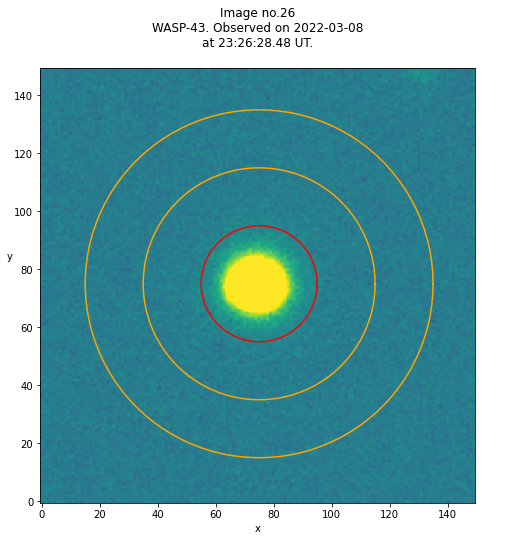

x_center: 75
y_center: 75
Mean sky background per pixel: 138.18394113883556
Signal (after background subtraction): 321709.9932821498
Flux uncertainty: 691.2742461481809


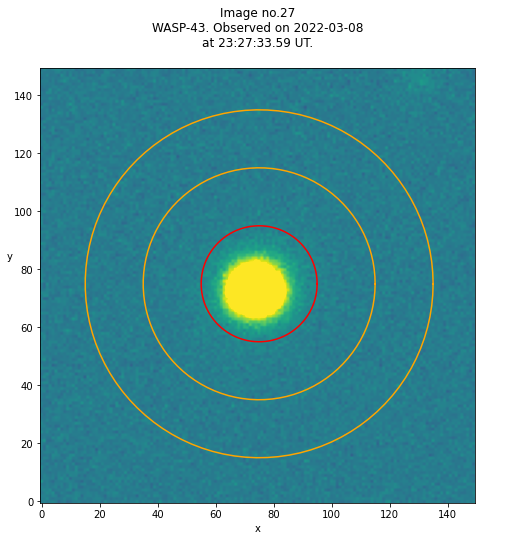

x_center: 75
y_center: 75
Mean sky background per pixel: 137.73448496481126
Signal (after background subtraction): 321857.5662188099
Flux uncertainty: 690.7666978013581


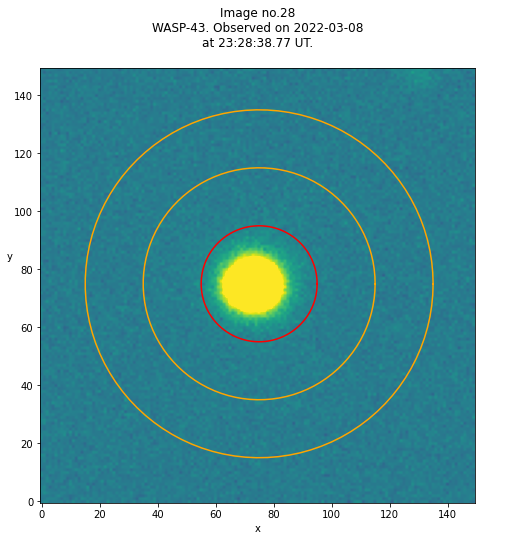

x_center: 75
y_center: 75
Mean sky background per pixel: 137.6332373640435
Signal (after background subtraction): 323031.6194817659
Flux uncertainty: 691.2419843998675


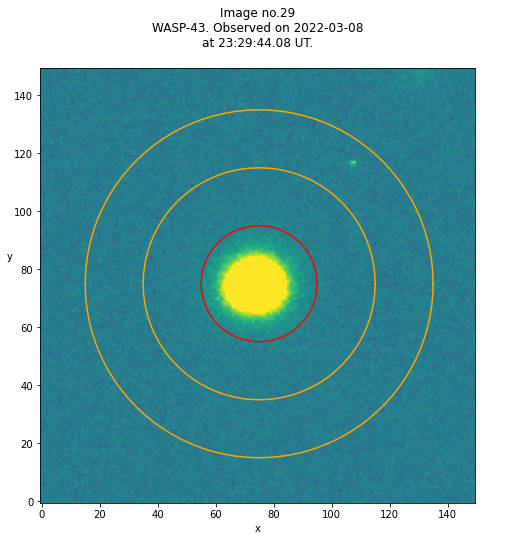

x_center: 75
y_center: 75
Mean sky background per pixel: 137.34085092770314
Signal (after background subtraction): 322410.64059500955
Flux uncertainty: 690.5411166225286


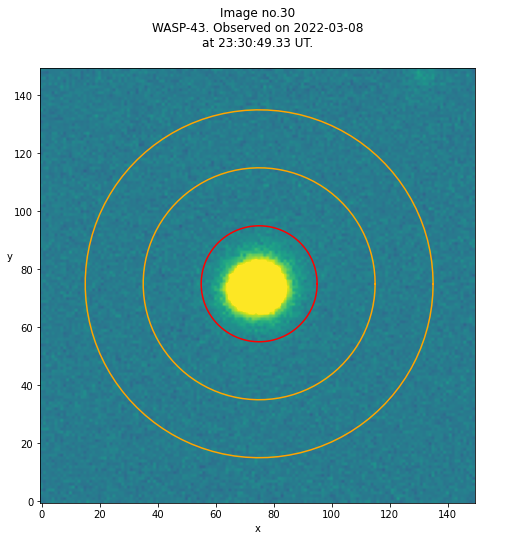

x_center: 75
y_center: 75
Mean sky background per pixel: 137.13051823416507
Signal (after background subtraction): 320595.5047984645
Flux uncertainty: 689.3278754038996


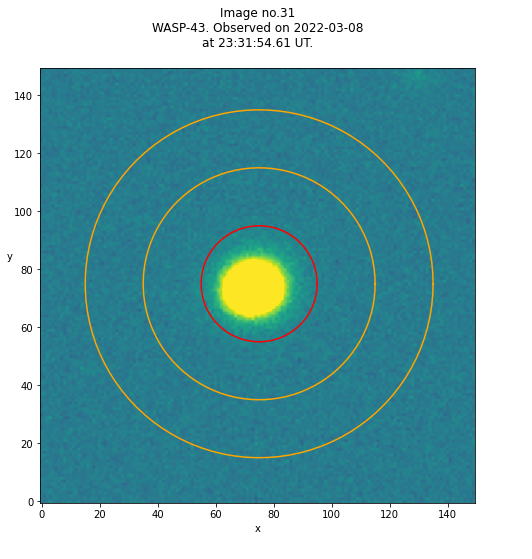

x_center: 75
y_center: 75
Mean sky background per pixel: 137.08221369161868
Signal (after background subtraction): 321751.6439539348
Flux uncertainty: 689.863767260851


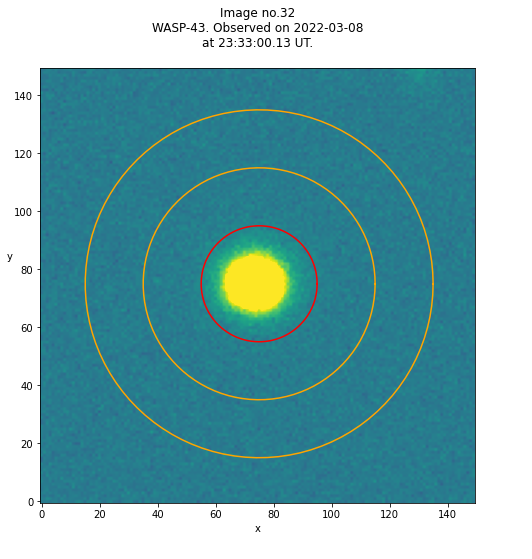

x_center: 75
y_center: 75
Mean sky background per pixel: 136.80470249520152
Signal (after background subtraction): 321130.14539347414
Flux uncertainty: 689.1806025283338


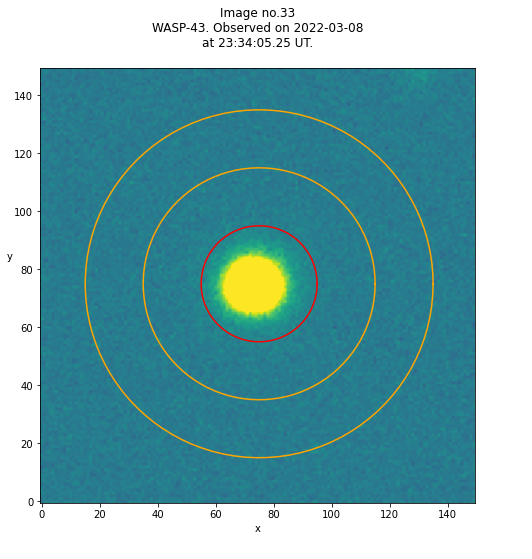

x_center: 75
y_center: 75
Mean sky background per pixel: 136.5505438259757
Signal (after background subtraction): 321485.57293666026
Flux uncertainty: 689.0337547187579


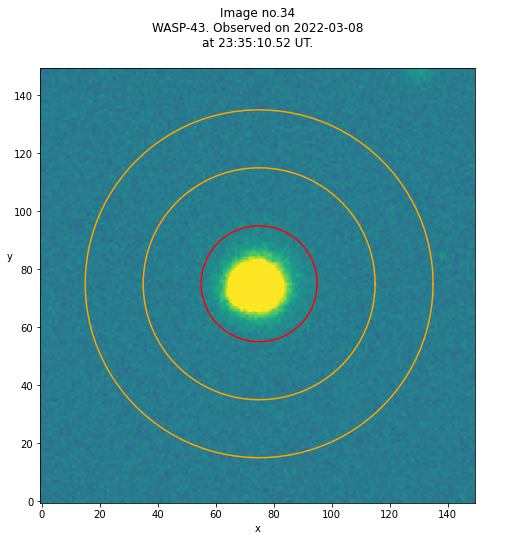

x_center: 75
y_center: 75
Mean sky background per pixel: 136.3178182981446
Signal (after background subtraction): 318872.3162188099
Flux uncertainty: 687.374072328827


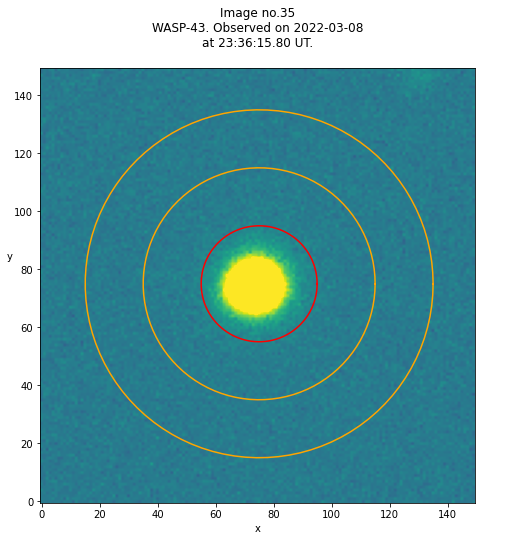

x_center: 75
y_center: 75
Mean sky background per pixel: 136.0670185540627
Signal (after background subtraction): 320554.5619001919
Flux uncertainty: 687.9204058031088


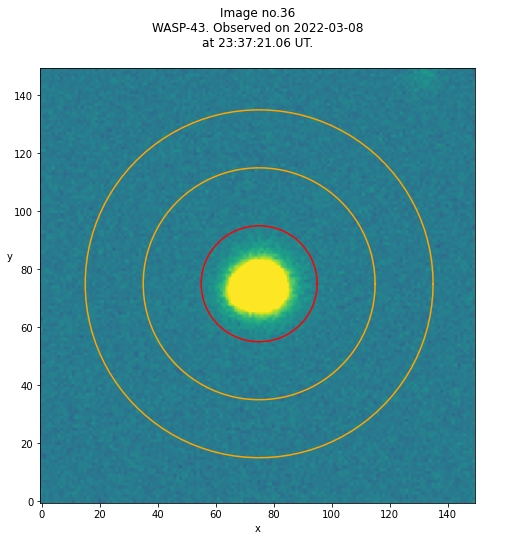

x_center: 75
y_center: 75
Mean sky background per pixel: 136.08157389635318
Signal (after background subtraction): 321996.4404990403
Flux uncertainty: 688.6875399588575


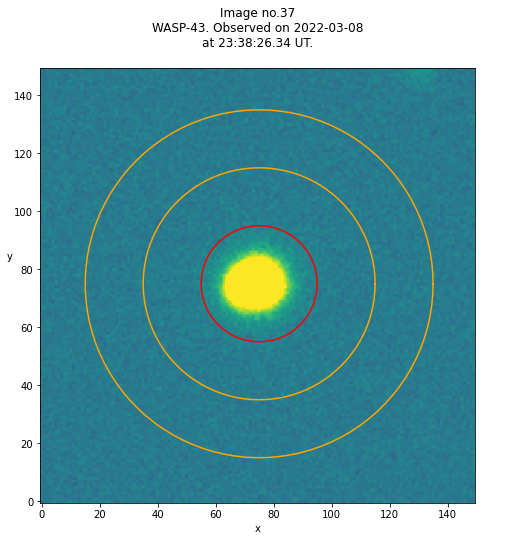

x_center: 75
y_center: 75
Mean sky background per pixel: 136.0076775431862
Signal (after background subtraction): 323988.44145873317
Flux uncertainty: 689.6236126322407


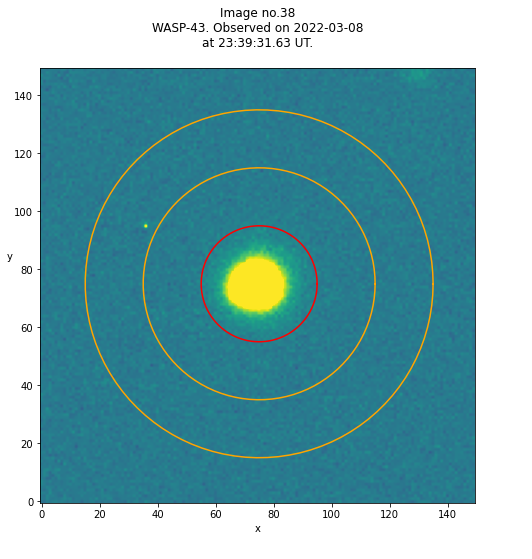

x_center: 75
y_center: 75
Mean sky background per pixel: 135.87907869481765
Signal (after background subtraction): 324930.54702495213
Flux uncertainty: 689.9440553657247


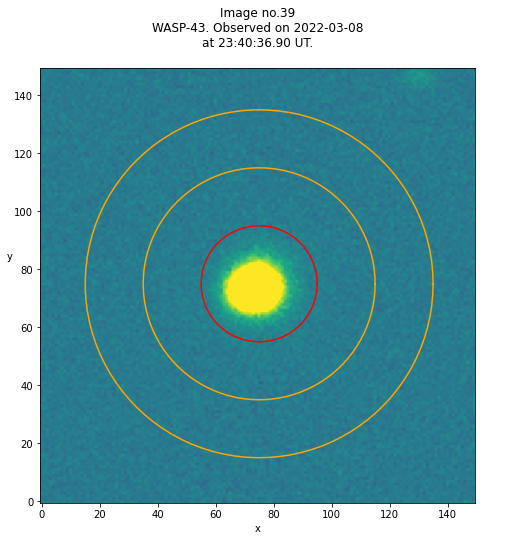

x_center: 75
y_center: 75
Mean sky background per pixel: 135.38227767114523
Signal (after background subtraction): 322385.06429942424
Flux uncertainty: 687.9772834008003


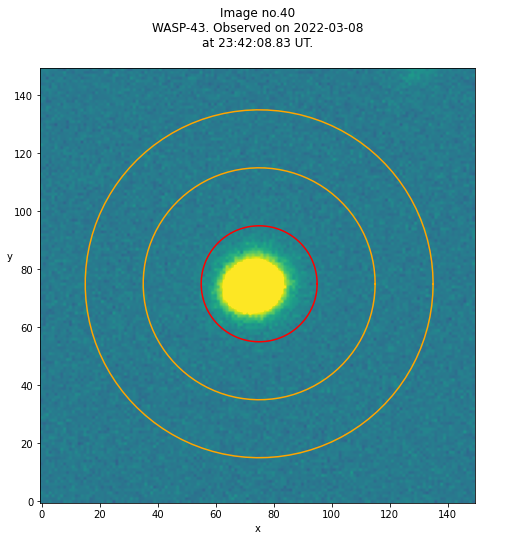

x_center: 75
y_center: 75
Mean sky background per pixel: 134.68490083173384
Signal (after background subtraction): 327095.29846449126
Flux uncertainty: 689.5108900344023


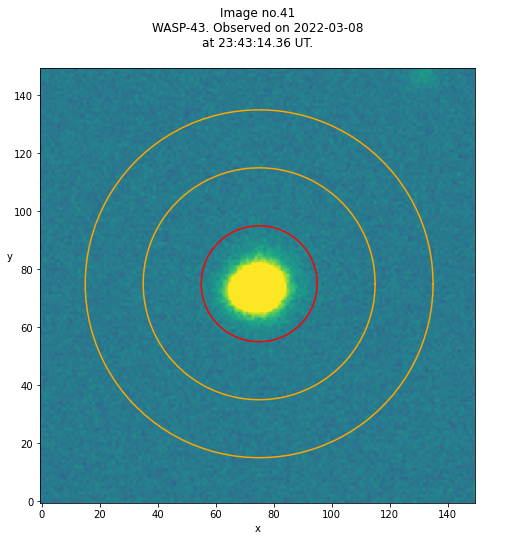

x_center: 75
y_center: 75
Mean sky background per pixel: 134.5910108765195
Signal (after background subtraction): 327861.1914587332
Flux uncertainty: 689.7853166362971


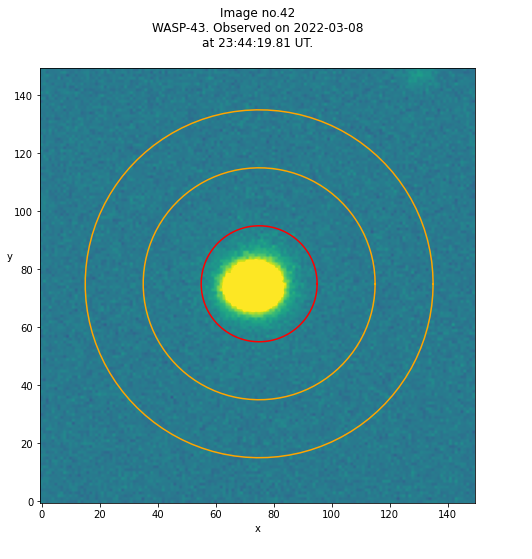

x_center: 75
y_center: 75
Mean sky background per pixel: 134.4195457453615
Signal (after background subtraction): 326448.6655470249
Flux uncertainty: 688.8301840683174


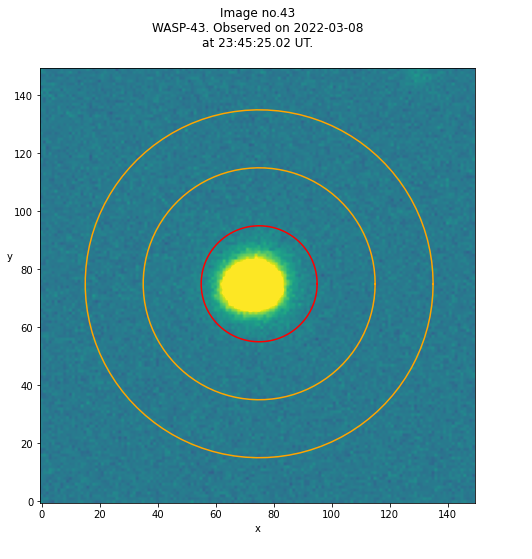

x_center: 75
y_center: 75
Mean sky background per pixel: 134.46369161868202
Signal (after background subtraction): 326307.703934741
Flux uncertainty: 688.8146239040935


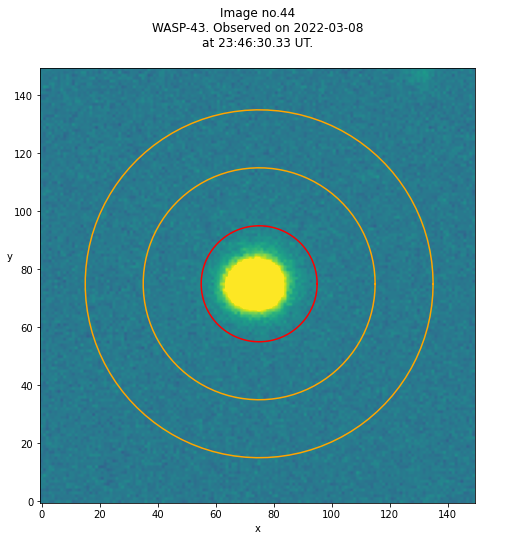

x_center: 75
y_center: 75
Mean sky background per pixel: 134.19241842610364
Signal (after background subtraction): 323982.439059501
Flux uncertainty: 687.2537334386026


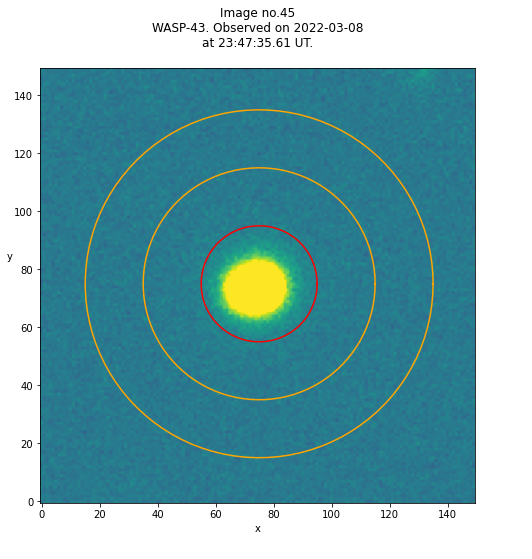

x_center: 75
y_center: 75
Mean sky background per pixel: 134.21065259117083
Signal (after background subtraction): 323821.7375239923
Flux uncertainty: 687.1940346152626


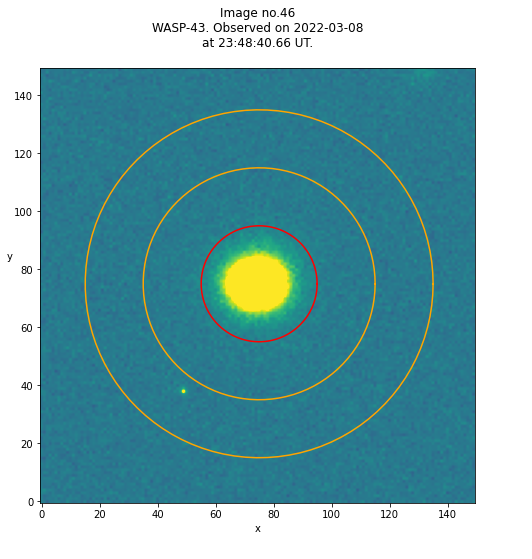

x_center: 75
y_center: 75
Mean sky background per pixel: 133.74872040946897
Signal (after background subtraction): 322297.84309021116
Flux uncertainty: 685.7972633900267


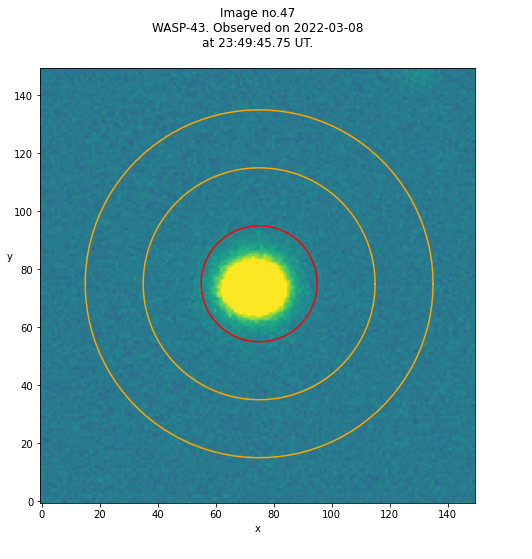

x_center: 75
y_center: 75
Mean sky background per pixel: 133.34660908509278
Signal (after background subtraction): 325222.4716890595
Flux uncertainty: 686.7933010298813


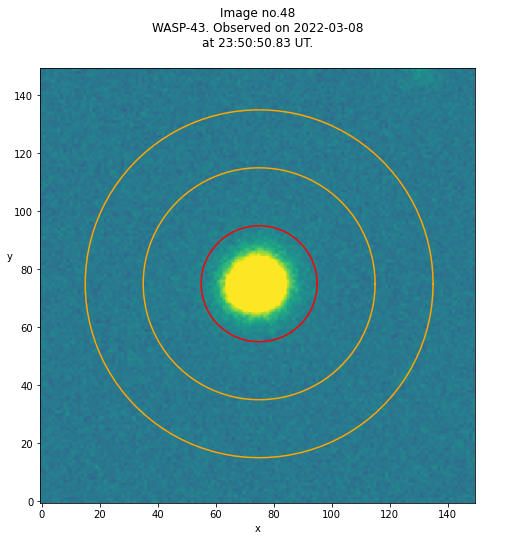

x_center: 75
y_center: 75
Mean sky background per pixel: 133.4548944337812
Signal (after background subtraction): 327755.65642994235
Flux uncertainty: 688.2505716779096


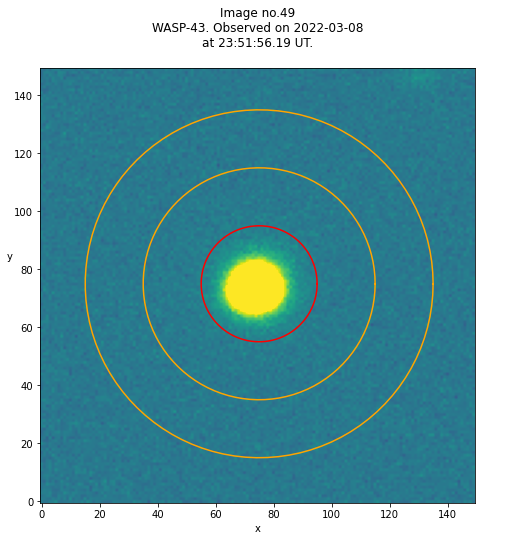

x_center: 75
y_center: 75
Mean sky background per pixel: 133.24136276391556
Signal (after background subtraction): 325922.5033589251
Flux uncertainty: 687.019740041649


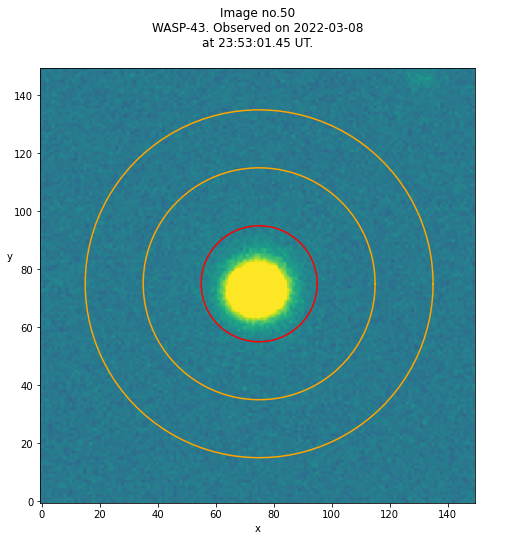

x_center: 75
y_center: 75
Mean sky background per pixel: 132.67546385156749
Signal (after background subtraction): 328256.0475047984
Flux uncertainty: 687.4933025870977


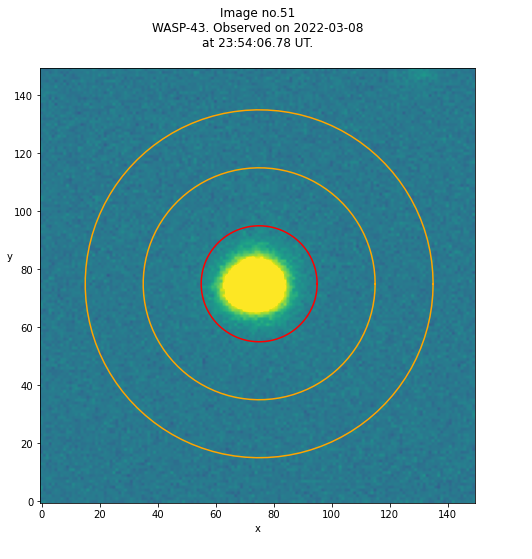

x_center: 75
y_center: 75
Mean sky background per pixel: 132.6092450415867
Signal (after background subtraction): 327415.48992322455
Flux uncertainty: 686.9699899557968


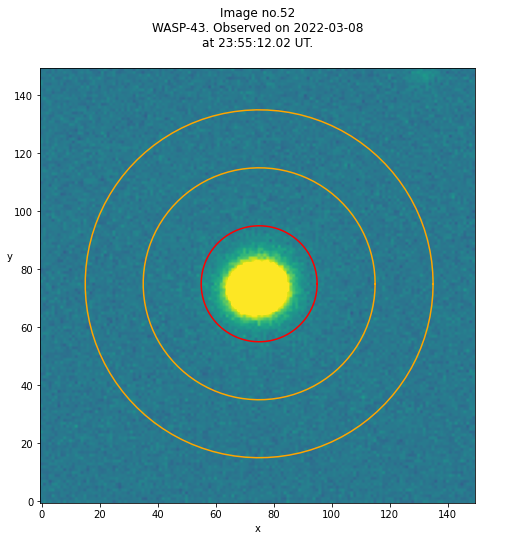

x_center: 75
y_center: 75
Mean sky background per pixel: 132.2551183621241
Signal (after background subtraction): 327595.3776391555
Flux uncertainty: 686.6007075419941


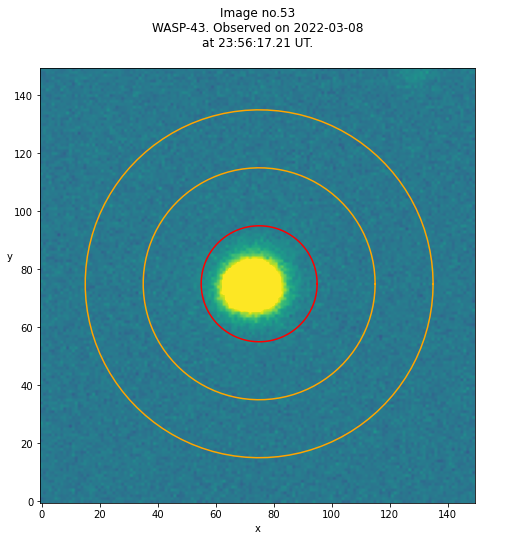

x_center: 75
y_center: 75
Mean sky background per pixel: 132.1204414587332
Signal (after background subtraction): 326403.0503838772
Flux uncertainty: 685.8039791809082


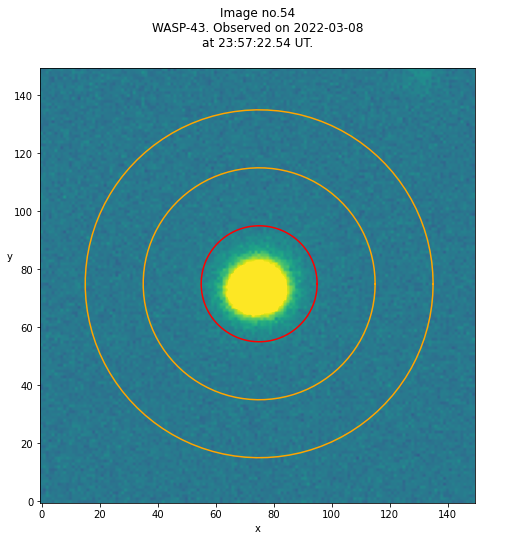

x_center: 75
y_center: 75
Mean sky background per pixel: 131.66250799744083
Signal (after background subtraction): 326926.1775431861
Flux uncertainty: 685.4769725451657


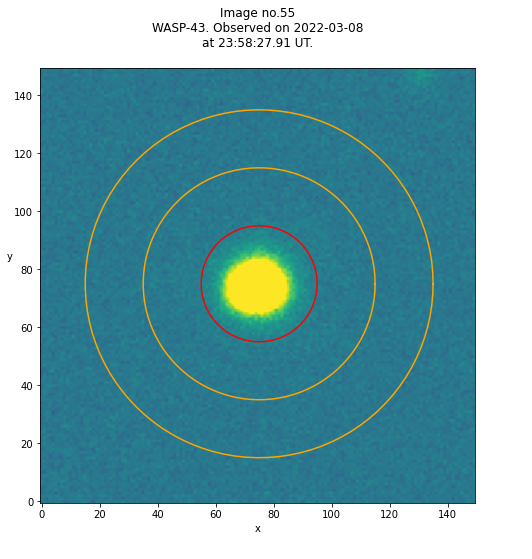

x_center: 75
y_center: 75
Mean sky background per pixel: 131.2372040946897
Signal (after background subtraction): 328661.68090211134
Flux uncertainty: 685.8241912948581


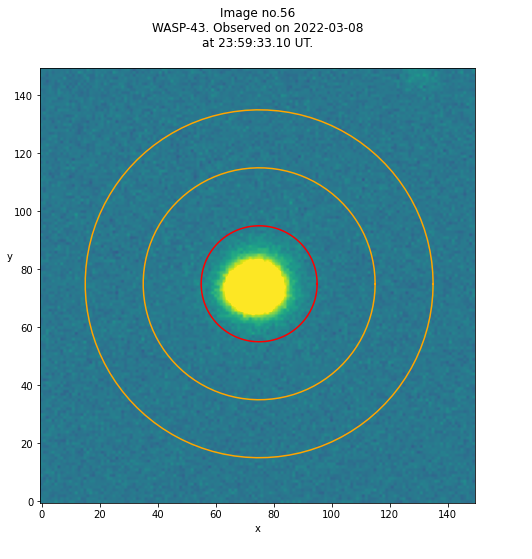

x_center: 75
y_center: 75
Mean sky background per pixel: 130.9465770953295
Signal (after background subtraction): 327988.5115163148
Flux uncertainty: 685.0928796305382


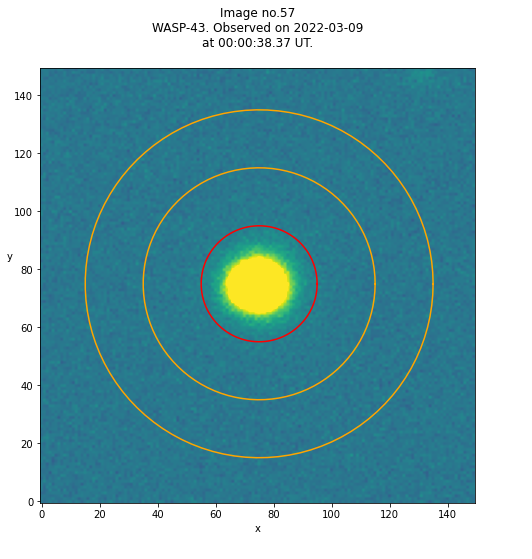

x_center: 75
y_center: 75
Mean sky background per pixel: 131.0051183621241
Signal (after background subtraction): 329012.6276391555
Flux uncertainty: 685.703185258151


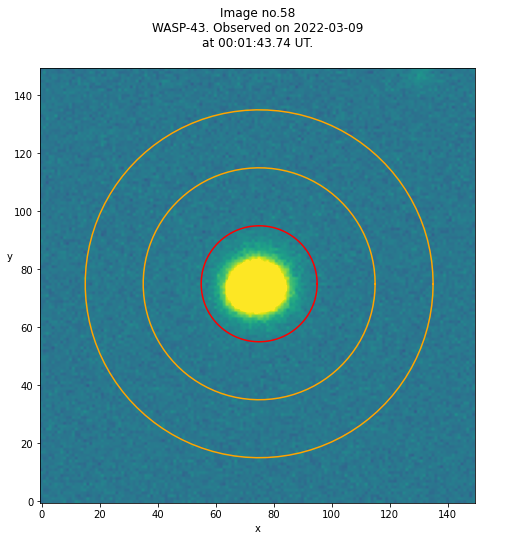

x_center: 75
y_center: 75
Mean sky background per pixel: 130.52207293666027
Signal (after background subtraction): 329481.019193858
Flux uncertainty: 685.3147178847084


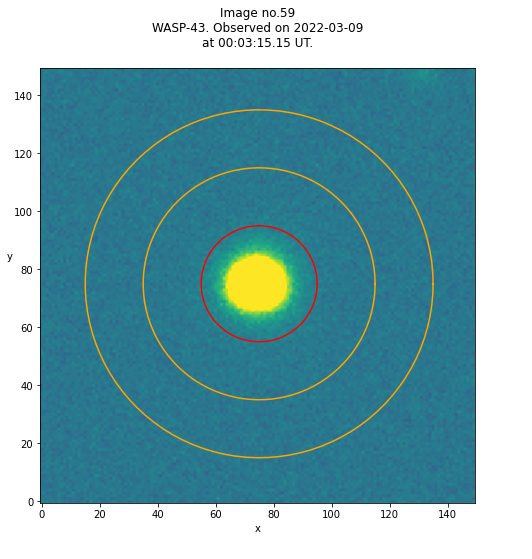

x_center: 75
y_center: 75
Mean sky background per pixel: 130.23096609085093
Signal (after background subtraction): 330572.4472168906
Flux uncertainty: 685.502195625131


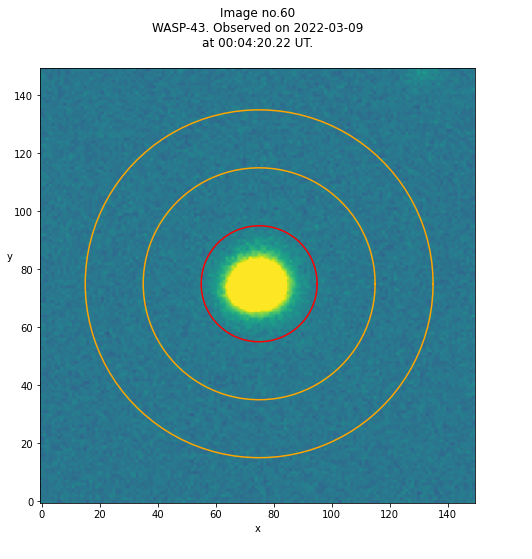

x_center: 75
y_center: 75
Mean sky background per pixel: 129.98128598848368
Signal (after background subtraction): 330881.2989443379
Flux uncertainty: 685.3361539507441


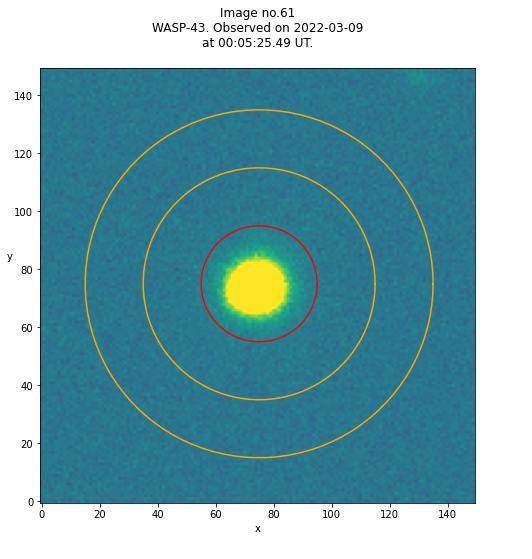

x_center: 75
y_center: 75
Mean sky background per pixel: 129.78119001919387
Signal (after background subtraction): 332514.41842610366
Flux uncertainty: 685.9248839220434


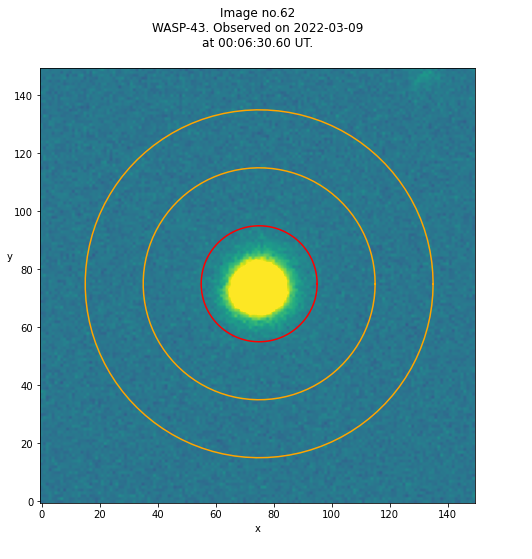

x_center: 75
y_center: 75
Mean sky background per pixel: 130.0195137555982
Signal (after background subtraction): 330544.70537428017
Flux uncertainty: 685.2108042496347


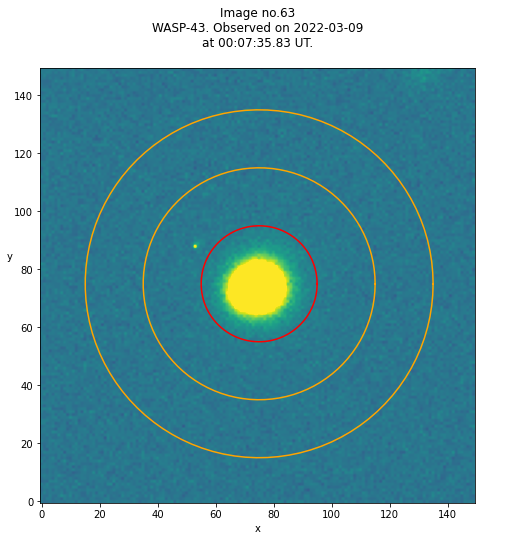

x_center: 75
y_center: 75
Mean sky background per pixel: 129.65419065898914
Signal (after background subtraction): 332583.5326295585
Flux uncertainty: 685.7946667577315


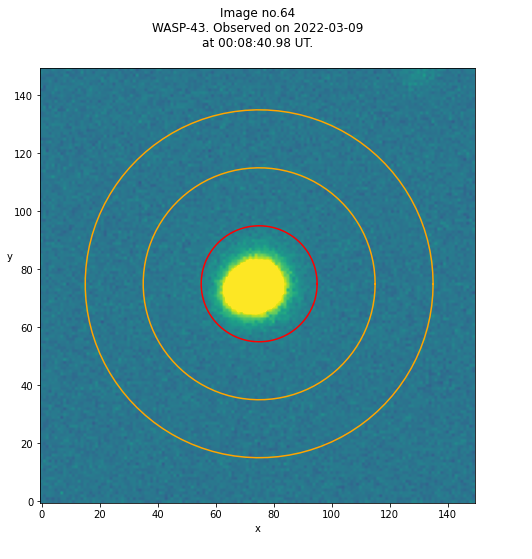

x_center: 75
y_center: 75
Mean sky background per pixel: 129.2122520793346
Signal (after background subtraction): 333144.74616122845
Flux uncertainty: 685.5084430397071


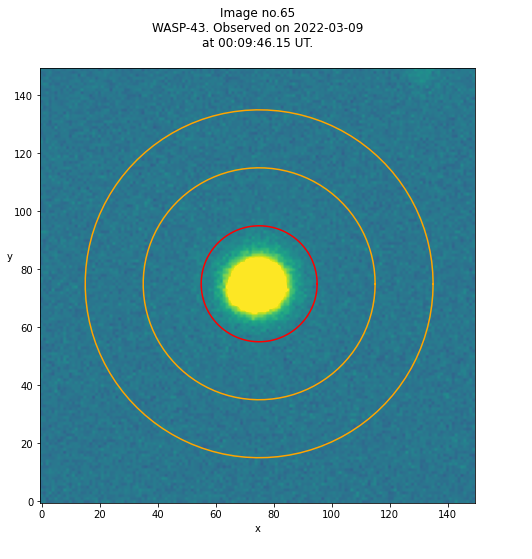

x_center: 75
y_center: 75
Mean sky background per pixel: 129.1665067178503
Signal (after background subtraction): 328489.69913627644
Flux uncertainty: 683.0187918414631


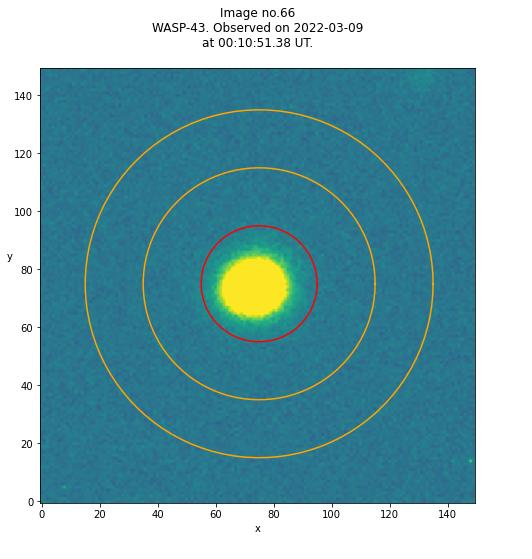

x_center: 75
y_center: 75
Mean sky background per pixel: 129.05534229046705
Signal (after background subtraction): 331003.09884836857
Flux uncertainty: 684.1859349649284


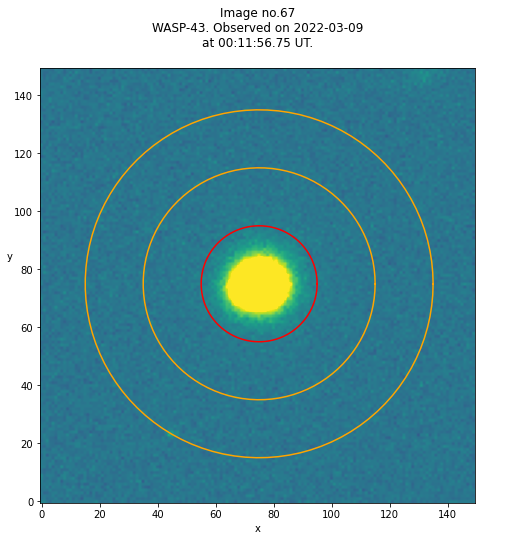

x_center: 75
y_center: 75
Mean sky background per pixel: 128.80934101087652
Signal (after background subtraction): 330405.3704414587
Flux uncertainty: 683.5508936994631


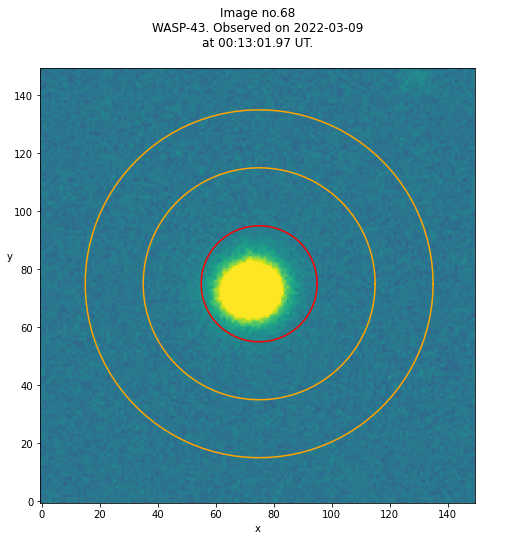

x_center: 75
y_center: 75
Mean sky background per pixel: 128.70601407549583
Signal (after background subtraction): 329914.0124760077
Flux uncertainty: 683.1583727228835


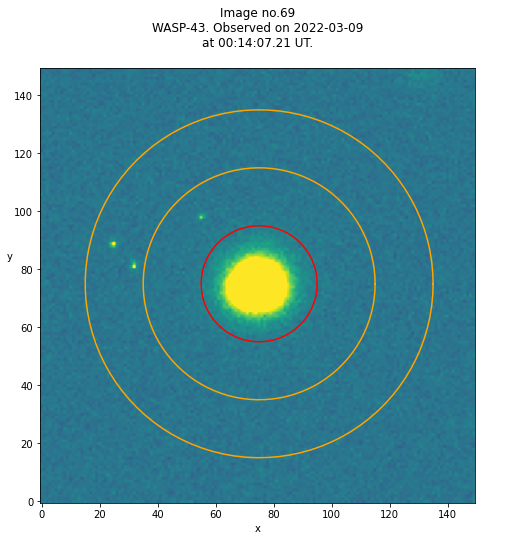

x_center: 75
y_center: 75
Mean sky background per pixel: 128.3517274472169
Signal (after background subtraction): 331739.09932821494
Flux uncertainty: 683.6468253560688


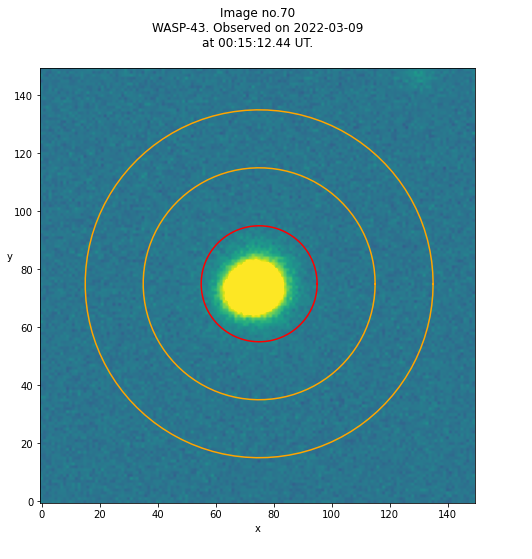

x_center: 75
y_center: 75
Mean sky background per pixel: 127.9758477287268
Signal (after background subtraction): 331432.06957773503
Flux uncertainty: 682.9926040317663


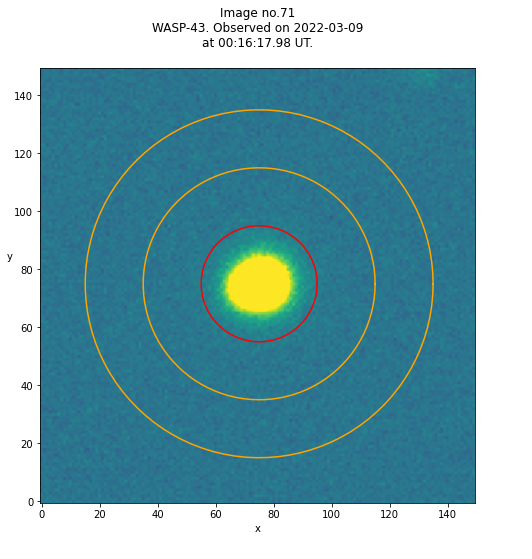

x_center: 75
y_center: 75
Mean sky background per pixel: 127.89475367882278
Signal (after background subtraction): 331747.03166986565
Flux uncertainty: 683.0507231436656


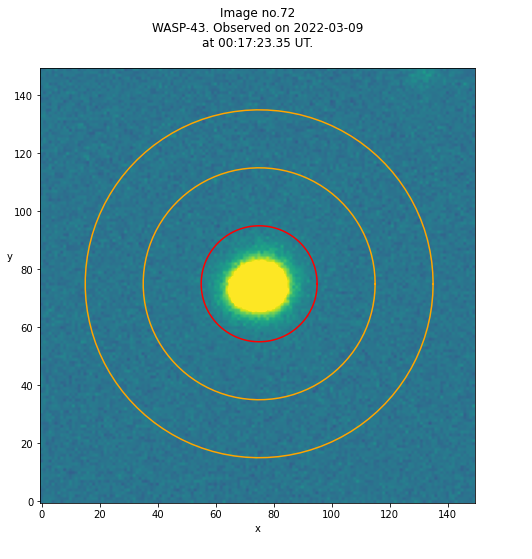

x_center: 75
y_center: 75
Mean sky background per pixel: 127.76167626359565
Signal (after background subtraction): 331208.71305182343
Flux uncertainty: 682.5942257822866


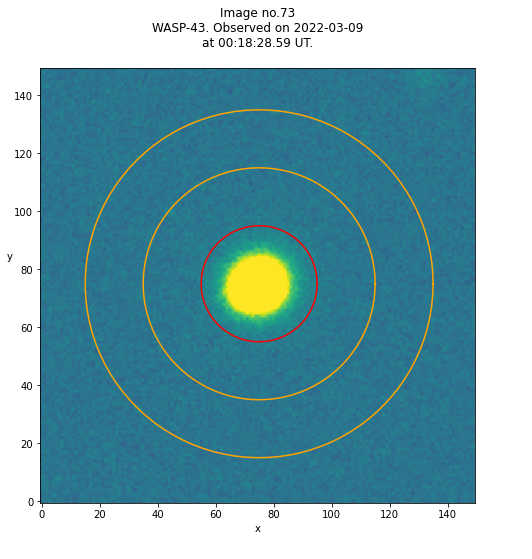

x_center: 75
y_center: 75
Mean sky background per pixel: 127.29430582213692
Signal (after background subtraction): 329526.5892514395
Flux uncertainty: 681.097892095208


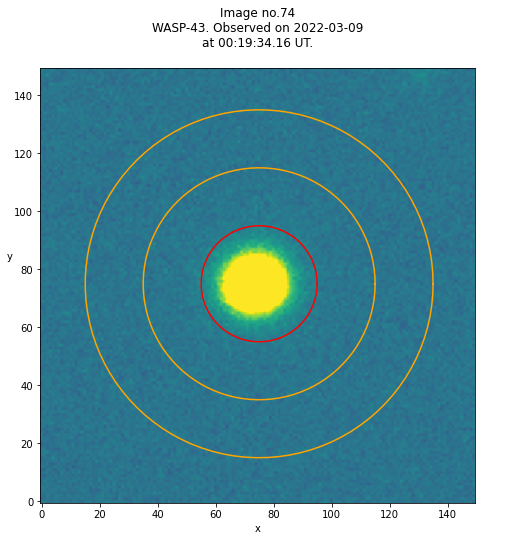

x_center: 75
y_center: 75
Mean sky background per pixel: 128.10044785668586
Signal (after background subtraction): 327736.9424184261
Flux uncertainty: 681.2218451036173


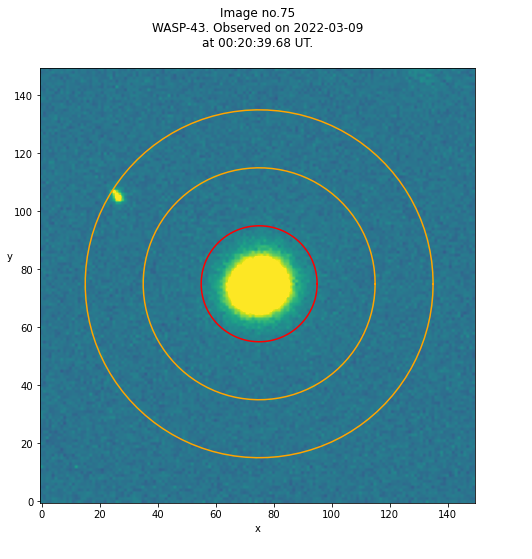

x_center: 75
y_center: 75
Mean sky background per pixel: 127.50351887396033
Signal (after background subtraction): 326763.1190019194
Flux uncertainty: 679.9235322356607


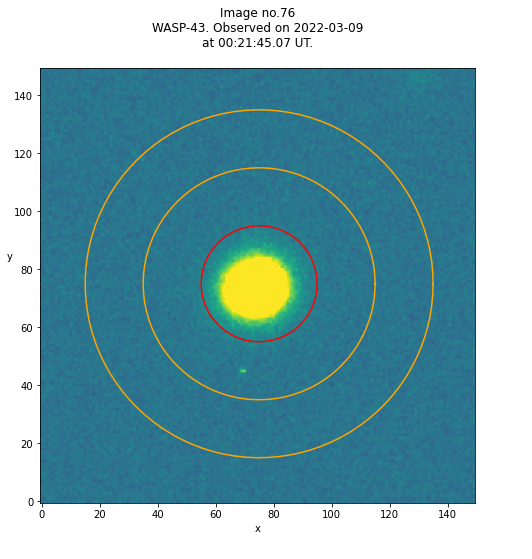

x_center: 75
y_center: 75
Mean sky background per pixel: 127.56813819577735
Signal (after background subtraction): 323323.6679462571
Flux uncertainty: 678.2000171549912


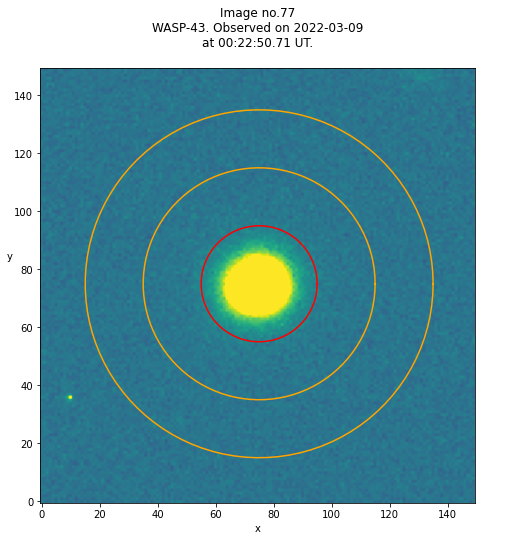

x_center: 75
y_center: 75
Mean sky background per pixel: 127.46049264235445
Signal (after background subtraction): 327146.6866602687
Flux uncertainty: 680.0681922250749


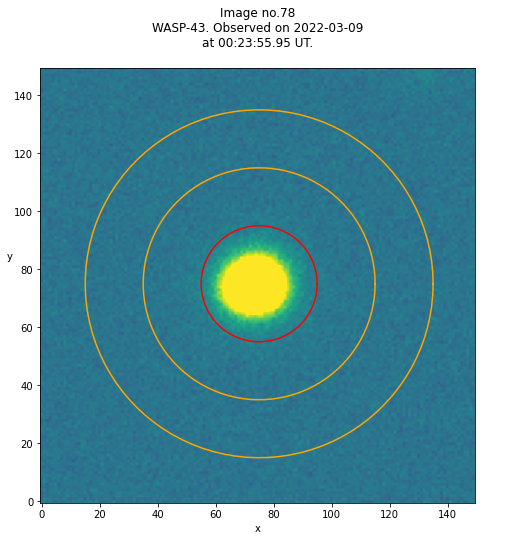

x_center: 75
y_center: 75
Mean sky background per pixel: 127.03055022392834
Signal (after background subtraction): 330920.9649712092
Flux uncertainty: 681.4813484834654


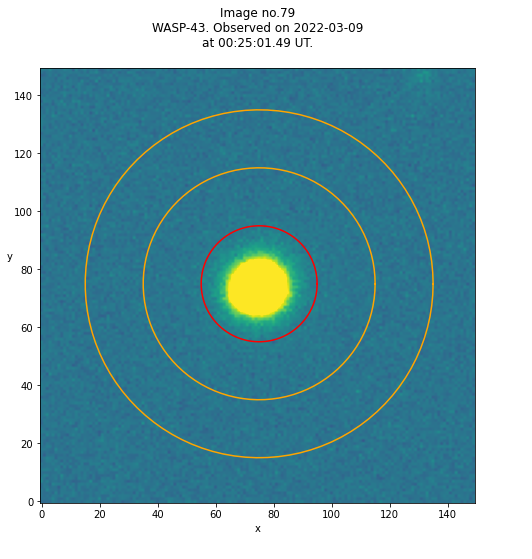

x_center: 75
y_center: 75
Mean sky background per pixel: 127.25959692898273
Signal (after background subtraction): 330997.8018234165
Flux uncertainty: 681.8232142425865


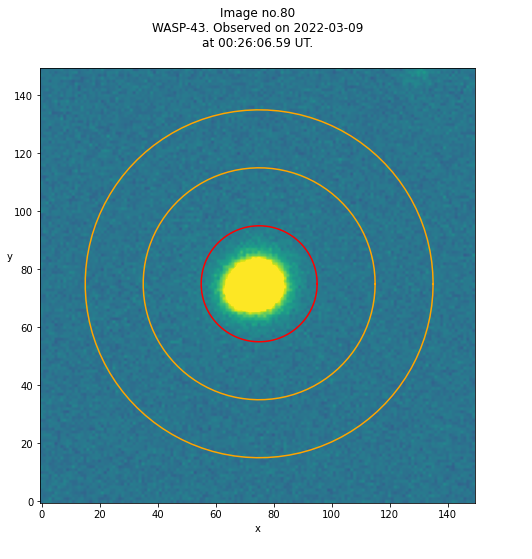

x_center: 75
y_center: 75
Mean sky background per pixel: 127.06973768394114
Signal (after background subtraction): 328092.17658349324
Flux uncertainty: 680.0489793834467


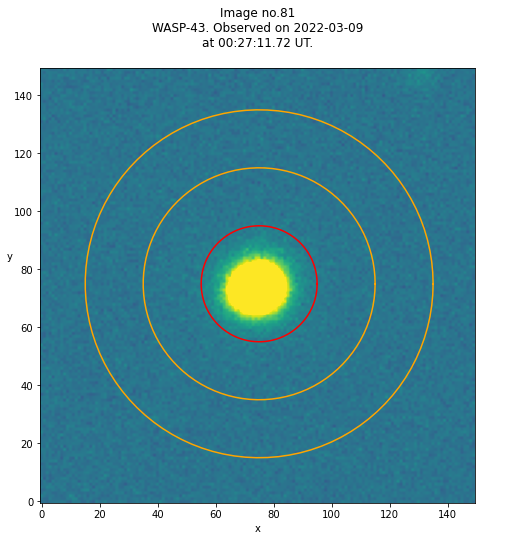

x_center: 75
y_center: 75
Mean sky background per pixel: 127.11260396673065
Signal (after background subtraction): 329683.80806142034
Flux uncertainty: 680.9408545229693


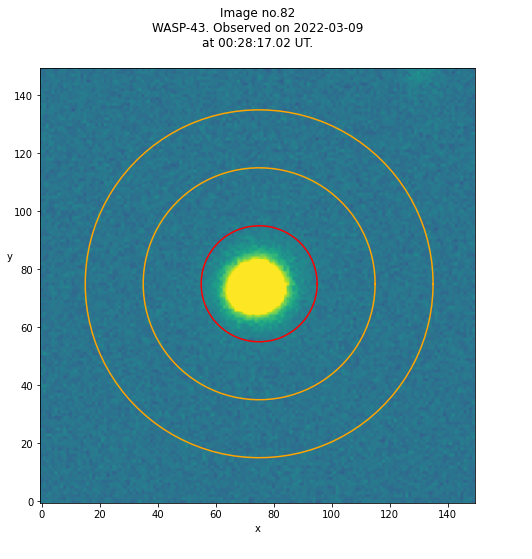

x_center: 75
y_center: 75
Mean sky background per pixel: 127.30246321177223
Signal (after background subtraction): 324304.4333013436
Flux uncertainty: 678.3648511938387


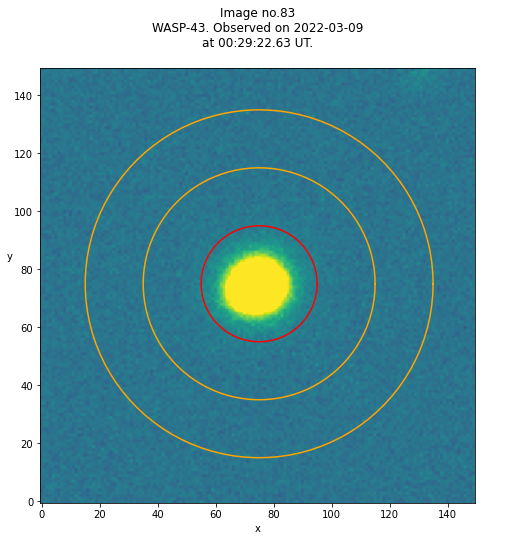

x_center: 75
y_center: 75
Mean sky background per pixel: 127.33669225847729
Signal (after background subtraction): 323654.8181381957
Flux uncertainty: 678.0680705838995


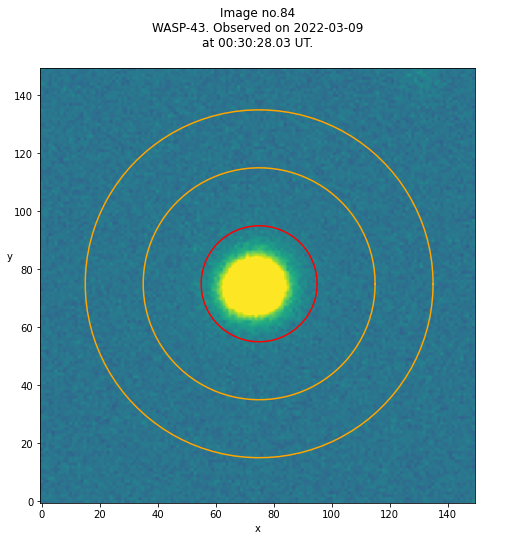

x_center: 75
y_center: 75
Mean sky background per pixel: 127.28326935380679
Signal (after background subtraction): 325693.3296545106
Flux uncertainty: 679.0703081608597


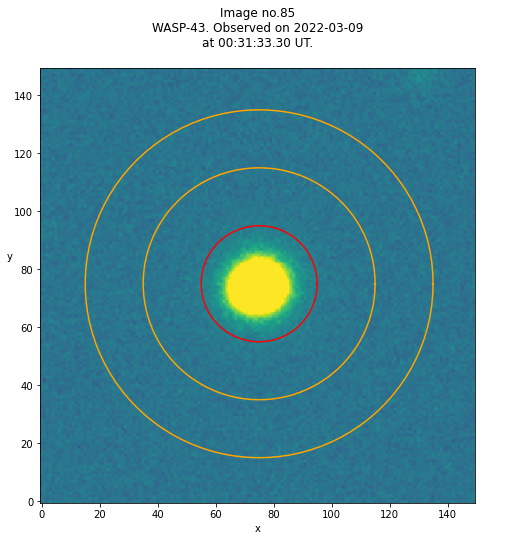

In [9]:
## Run the program:    

#Set the canvas:
fig0, ax0 = plt.subplots();

fits_image_filename0 =''

# Run:

for i in range(0,len(fits_image_filename_list)):    # repeat for all images in the folder

    fits_image_filename0 = fits_image_filename_list[i]   # set the image for current iteration
    
    main()     # run the program, do aperture photometry
    plt.show() # shows esch image after its printed text (instead of the text from allimages first, then images otherwise,
               # or only the final image)

In [10]:
## Save the measurements in an array, then convert it to a Pandas dataframe (table):
photom_results_array = cell_text

## Convert to Pandas table:
photom_results_table = pd.DataFrame(photom_results_array, columns = ['Star','Sky','Flux uncertainty','Julian Date','Year','Month','Day','Hour','Minute','Second'])
print(photom_results_table)

           Star       Sky  Flux uncertainty      Julian Date  Year Month Day  \
0   334438.6660  141.7159            702.35  2459647.4580524  2022    03  08   
1   335353.8522  141.7134            702.81  2459647.4580524  2022    03  08   
2   334041.0969  141.5365            701.92  2459647.4590435  2022    03  08   
3   335143.9962  141.6289            702.60  2459647.4598019  2022    03  08   
4   331255.6324  141.3023            700.20  2459647.4605595  2022    03  08   
..          ...       ...               ...              ...   ...   ...  ..   
80  328092.1766  127.0697            680.05  2459647.5188856  2022    03  09   
81  329683.8081  127.1126            680.94  2459647.5196414  2022    03  09   
82  324304.4333  127.3025            678.36  2459647.5204008  2022    03  09   
83  323654.8181  127.3367            678.07  2459647.5211578  2022    03  09   
84  325693.3297  127.2833            679.07  2459647.5219132  2022    03  09   

   Hour Minute Second  
0    22     59 

In [12]:
## Export the Pandas table to a CSV spreadsheet (this will be saved in the same folder where this notebook was saved):
photom_results_table.to_csv (r'Photometry_results.csv', index = True, header=True);

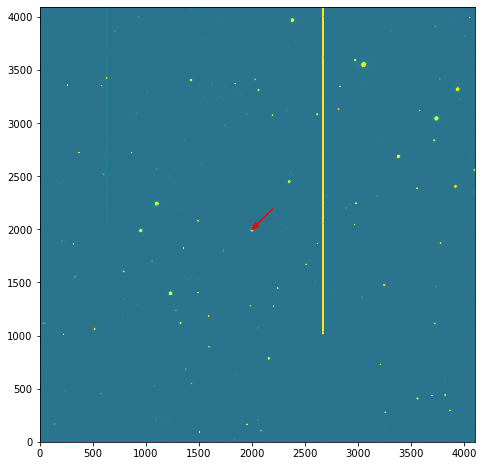

In [13]:
## Verify the position of your target within the CCD frame:
plt.imshow(large0, origin='lower',cmap=cmap_value0,vmin=low_lim0/100*np.max(large0),vmax=hi_lim0/100*np.max(large0))
plt.arrow(y_center0+y_corner_lo+200,x_center0+x_corner_lo+200,-200,-200,head_width=50,color='red',length_includes_head=True)

In [14]:
## Calculate the target's signal in photoelectrons by multiplying the ADU signal by the gain of the CCD:
CCD_gain = 1.4
signal_list_photoel = CCD_gain * np.array(signal_list)

Text(0.5, 1.0, 'Uncalibrated WASP-43b Light Curve')

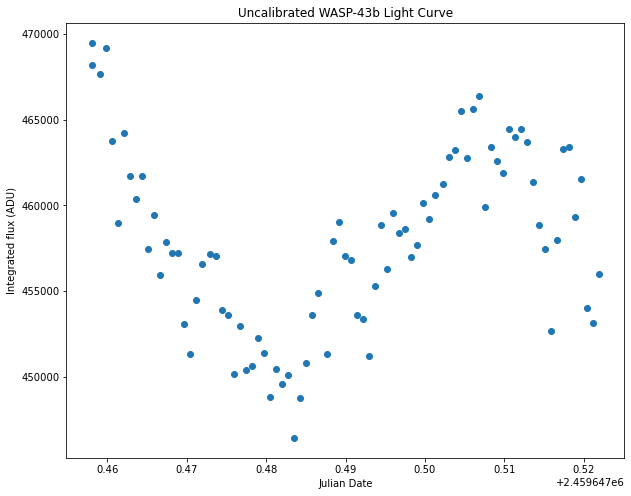

In [15]:
## Plot the uncalibrated light curve:
plt.plot(JD_time_list,signal_list_photoel,'o')
plt.ylabel('Integrated flux (ADU)')
plt.xlabel('Julian Date')
plt.title('Uncalibrated WASP-43b Light Curve')